<a href="https://colab.research.google.com/github/Nishi07452/Data_T/blob/main/Labmentix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

FBI-Time Series Project
Contribution-
Veeragota Narsingrao

Project Summary

The goal of this project was to analyze historical crime data with the aim of forecasting future crime trends. The data set includes various features like the date, time, location, type of crime, and demographic information of the area, spanning multiple years. An extensive preprocessing, which involved handling missing values, removing duplicates, and adding time-based features such as weekend vs. weekday and time of day. We also encoded categorical variables to make the data suitable for time-series forecasting.

Through exploratory data analysis (EDA), we identified key patterns in crime distribution, such as peak crime times and seasonal trends. The next steps involve using time-series forecasting techniques to predict future crime rates.




In [ ]:
#GitHub Link


                          Problem Statement
The rising crime rates in urban areas pose significant challenges for law enforcement and community safety. This project aims to develop a predictive model that forecasts crime incidents based on historical data, including crime type, location, and time. By identifying high-risk areas and periods, the model will help optimize resource allocation, enhance public safety measures, and support data-driven decision-making for crime prevention.

#import libraries
import pandas as pd
import numpy as np

In [ ]:
#load dataset
df=pd.read_excel(r"/content/Train.xlsx")

In [ ]:
#dataset first look
print(df.head())

print(df.columns)

          TYPE     HUNDRED_BLOCK NEIGHBOURHOOD         X           Y  \
0  Other Theft  9XX TERMINAL AVE    Strathcona  493906.5  5457452.47   
1  Other Theft  9XX TERMINAL AVE    Strathcona  493906.5  5457452.47   
2  Other Theft  9XX TERMINAL AVE    Strathcona  493906.5  5457452.47   
3  Other Theft  9XX TERMINAL AVE    Strathcona  493906.5  5457452.47   
4  Other Theft  9XX TERMINAL AVE    Strathcona  493906.5  5457452.47   

    Latitude   Longitude  HOUR  MINUTE  YEAR  MONTH  DAY       Date  
0  49.269802 -123.083763  16.0    15.0  1999      5   12 1999-05-12  
1  49.269802 -123.083763  15.0    20.0  1999      5    7 1999-05-07  
2  49.269802 -123.083763  16.0    40.0  1999      4   23 1999-04-23  
3  49.269802 -123.083763  11.0    15.0  1999      4   20 1999-04-20  
4  49.269802 -123.083763  17.0    45.0  1999      4   12 1999-04-12  
Index(['TYPE', 'HUNDRED_BLOCK', 'NEIGHBOURHOOD', 'X', 'Y', 'Latitude',
       'Longitude', 'HOUR', 'MINUTE', 'YEAR', 'MONTH', 'DAY', 'Date'],
     

In [ ]:
print(df.dtypes)

TYPE                     object
HUNDRED_BLOCK            object
NEIGHBOURHOOD            object
X                       float64
Y                       float64
Latitude                float64
Longitude               float64
HOUR                    float64
MINUTE                  float64
YEAR                      int64
MONTH                     int64
DAY                       int64
Date             datetime64[ns]
dtype: object


In [ ]:
#counting the rows and columns in the dataframe
print(df.shape[0]) #rows
print(df.shape[1])#columns

474565
13


In [ ]:
#getting basic details
print(df.describe())

                   X             Y       Latitude      Longitude  \
count  474565.000000  4.745650e+05  474565.000000  474565.000000   
mean   441028.018220  4.889023e+06      44.138029    -110.301025   
min         0.000000  0.000000e+00       0.000000    -124.549757   
25%    489916.530000  5.453572e+06      49.234871    -123.127383   
50%    491477.850000  5.456820e+06      49.264051    -123.107058   
75%    493610.190000  5.458622e+06      49.280300    -123.065646   
max    511303.000000  5.512579e+06      49.755314       0.000000   
std    150295.319332  1.665850e+06      15.039271      37.583147   

                HOUR         MINUTE           YEAR          MONTH  \
count  425200.000000  425200.000000  474565.000000  474565.000000   
mean       13.721263      16.736047    2004.363632       6.555700   
min         0.000000       0.000000    1999.000000       1.000000   
25%         9.000000       0.000000    2001.000000       4.000000   
50%        15.000000      10.000000    200

In [ ]:
#counting the duplicate values
dup_values=df.duplicated().sum()
print(f"The count of duplicated values is {dup_values}")

The count of duplicated values is 44618


In [ ]:
#missing or null values count
Mis_values=df.isna().sum()
Mis_values=df.isnull().sum()
print(f"The count of missing values is {Mis_values}")

The count of missing values is TYPE                 0
HUNDRED_BLOCK       13
NEIGHBOURHOOD    51491
X                    0
Y                    0
Latitude             0
Longitude            0
HOUR             49365
MINUTE           49365
YEAR                 0
MONTH                0
DAY                  0
Date                 0
dtype: int64


In [ ]:
Mis_percentage=(df.isnull().sum()/len(df))*100
print(Mis_percentage)

TYPE              0.000000
HUNDRED_BLOCK     0.002739
NEIGHBOURHOOD    10.850147
X                 0.000000
Y                 0.000000
Latitude          0.000000
Longitude         0.000000
HOUR             10.402158
MINUTE           10.402158
YEAR              0.000000
MONTH             0.000000
DAY               0.000000
Date              0.000000
dtype: float64


In [ ]:
#highliting the missing values
df.style.highlight_null(color="red")

,TYPE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y,Latitude,Longitude,HOUR,MINUTE,YEAR,MONTH,DAY,Date
0,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,16.000000,15.000000,1999,5,12,1999-05-12 00:00:00
1,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,15.000000,20.000000,1999,5,7,1999-05-07 00:00:00
2,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,16.000000,40.000000,1999,4,23,1999-04-23 00:00:00
3,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,11.000000,15.000000,1999,4,20,1999-04-20 00:00:00
4,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,17.000000,45.000000,1999,4,12,1999-04-12 00:00:00
5,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,20.000000,45.000000,1999,3,26,1999-03-26 00:00:00
6,Break and Enter Residential/Other,63XX WILTSHIRE ST,Kerrisdale,489325.580000,5452817.950000,49.228051,-123.146610,12.000000,0.000000,1999,3,10,1999-03-10 00:00:00
7,Mischief,40XX W 19TH AVE,Dunbar-Southlands,485903.090000,5455883.770000,49.255559,-123.193725,4.000000,13.000000,1999,6,28,1999-06-28 00:00:00
8,Other Theft,9XX TERMINAL AVE,Strathcona,493906.500000,5457452.470000,49.269802,-123.083763,9.000000,2.000000,1999,2,16,1999-02-16 00:00:00
9,Break and Enter Residential/Other,18XX E 3RD AVE,Grandview-Woodland,495078.190000,5457221.380000,49.267734,-123.067654,18.000000,15.000000,1999,7,9,1999-07-09 00:00:00


In [ ]:
#Handling the missing values
#Since only 0.0027% of rows have missing values, we can drop them safely:

df.dropna(subset=["HUNDRED_BLOCK"],inplace=True)

In [ ]:
#NEIGHBOURHOOD (Missing: 51,491 rows)
#since it is a lot we aren't deleting them we are filling them based on location forward fill
# df["NEIGHBOURHOOD"].fillna(method="ffill",inplace=True)
df.loc[:, "NEIGHBOURHOOD"] = df["NEIGHBOURHOOD"].ffill()


In [ ]:
'''Handle Missing HOUR and MINUTE Values (10.4%)'''
'''Handle Missing HOUR and MINUTE Values (10.4%)
Since crime time is important for forecasting, we shouldn’t drop these rows unless necessary.'''
#Since we see clear crime peaks at specific hours, we should fill missing values using the mode (most frequent hour).
most_common_hour=df["HOUR"].mode()[0]
df.loc[:, 'HOUR'] = df['HOUR'].fillna(most_common_hour)
# df['HOUR'].fillna(most_common_hour, inplace=True)



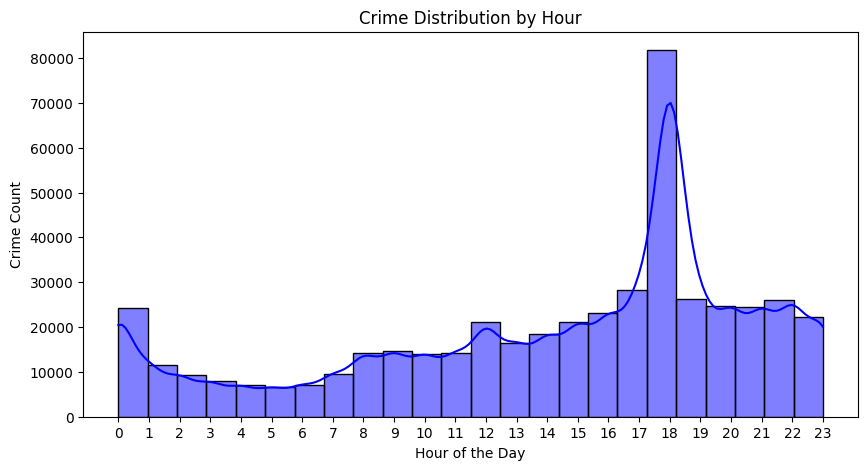

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 5))
sns.histplot(df['HOUR'].dropna(), bins=24, kde=True, color='blue')
plt.xticks(range(0, 24))
plt.xlabel("Hour of the Day")
plt.ylabel("Crime Count")
plt.title("Crime Distribution by Hour")
plt.show()


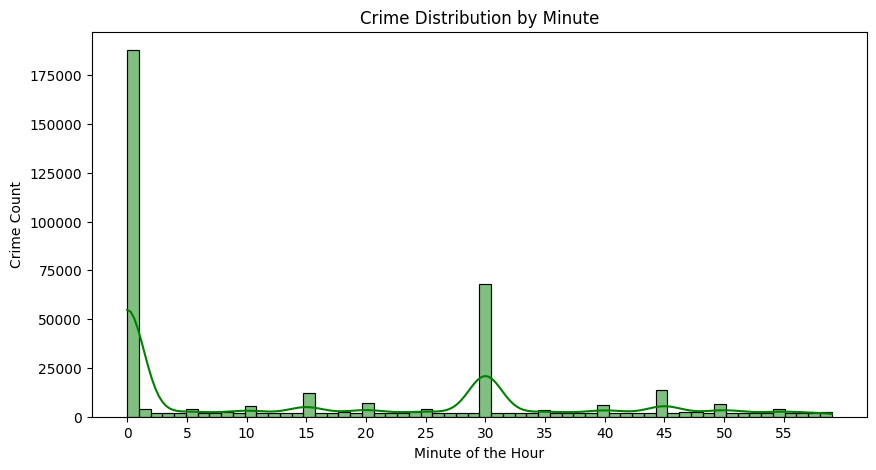

In [ ]:
plt.figure(figsize=(10, 5))
sns.histplot(df['MINUTE'].dropna(), bins=60, kde=True, color='green')
plt.xticks(range(0, 60, 5))  # Show ticks every 5 minutes
plt.xlabel("Minute of the Hour")
plt.ylabel("Crime Count")
plt.title("Crime Distribution by Minute")
plt.show()

In [ ]:
#filling minutes values with 0 as per graph
df['MINUTE'] = df['MINUTE'].fillna(0)


In [ ]:
#verifying the fixes
print(df.isnull().sum())

TYPE                 0
HUNDRED_BLOCK       13
NEIGHBOURHOOD    51491
X                    0
Y                    0
Latitude             0
Longitude            0
HOUR                 0
MINUTE               0
YEAR                 0
MONTH                0
DAY                  0
Date                 0
dtype: int64


In [ ]:
#remove exact duplicates
df=df.drop_duplicates()

In [ ]:
#Confirming that there are no duplicates
print(f"Remaining duplicate values: {df.duplicated().sum()}")


Remaining duplicate values: 0


In [ ]:
#resetting index
#since we have deleted a few records it is important to reset the index
df=df.reset_index(drop=True)

In [ ]:
#we are adding a new columns to know from the data if the crime occured on a weekday or a weekend
df['WEEKDAY'] = pd.to_datetime(df['Date']).dt.weekday  # 0 = Monday, 6 = Sunday
df['IS_WEEKEND'] = df['WEEKDAY'].isin([5, 6]).astype(int)  # 1 for Sat/Sun, 0 for weekdays


<ipython-input-21-3a82953baa09>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['WEEKDAY'] = pd.to_datetime(df['Date']).dt.weekday  # 0 = Monday, 6 = Sunday
<ipython-input-21-3a82953baa09>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['IS_WEEKEND'] = df['WEEKDAY'].isin([5, 6]).astype(int)  # 1 for Sat/Sun, 0 for weekdays


In [ ]:
print(df.head(10))

                                TYPE      HUNDRED_BLOCK       NEIGHBOURHOOD  \
0                        Other Theft   9XX TERMINAL AVE          Strathcona   
1                        Other Theft   9XX TERMINAL AVE          Strathcona   
2                        Other Theft   9XX TERMINAL AVE          Strathcona   
3                        Other Theft   9XX TERMINAL AVE          Strathcona   
4                        Other Theft   9XX TERMINAL AVE          Strathcona   
5                        Other Theft   9XX TERMINAL AVE          Strathcona   
6  Break and Enter Residential/Other  63XX WILTSHIRE ST          Kerrisdale   
7                           Mischief    40XX W 19TH AVE   Dunbar-Southlands   
8                        Other Theft   9XX TERMINAL AVE          Strathcona   
9  Break and Enter Residential/Other     18XX E 3RD AVE  Grandview-Woodland   

           X           Y   Latitude   Longitude  HOUR  MINUTE  YEAR  MONTH  \
0  493906.50  5457452.47  49.269802 -123.083763  16.

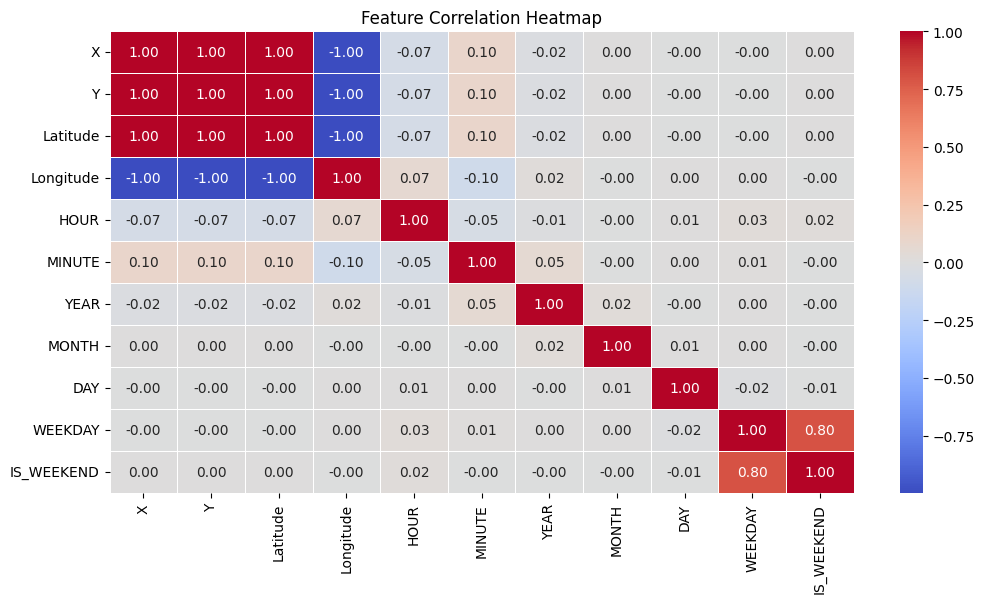

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Compute correlation matrix
numerical_features = df.select_dtypes(include=['number']).columns

corr_matrix = df[numerical_features].corr()

# Plot heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)
plt.title("Feature Correlation Heatmap")
plt.show()

In [ ]:
#Dropping Redundant Features
df = df.drop(columns=["X", "Y", "Longitude", "WEEKDAY"])  # Keeping Latitude and IS_WEEKEND


In [ ]:
print(df.head(10))

                                TYPE      HUNDRED_BLOCK       NEIGHBOURHOOD  \
0                        Other Theft   9XX TERMINAL AVE          Strathcona   
1                        Other Theft   9XX TERMINAL AVE          Strathcona   
2                        Other Theft   9XX TERMINAL AVE          Strathcona   
3                        Other Theft   9XX TERMINAL AVE          Strathcona   
4                        Other Theft   9XX TERMINAL AVE          Strathcona   
5                        Other Theft   9XX TERMINAL AVE          Strathcona   
6  Break and Enter Residential/Other  63XX WILTSHIRE ST          Kerrisdale   
7                           Mischief    40XX W 19TH AVE   Dunbar-Southlands   
8                        Other Theft   9XX TERMINAL AVE          Strathcona   
9  Break and Enter Residential/Other     18XX E 3RD AVE  Grandview-Woodland   

    Latitude  HOUR  MINUTE  YEAR  MONTH  DAY       Date  IS_WEEKEND  
0  49.269802  16.0    15.0  1999      5   12 1999-05-12     

A line chart is an effective way to visualize crime trends over time because it allows us to track changes in crime count on a continuous timeline.
The crime count appears to have a relatively stable trend with some fluctuations over time.

The law enforcement should understand why these spikes occurred, they can implement preventive measures to avoid similar occurrences in the future.

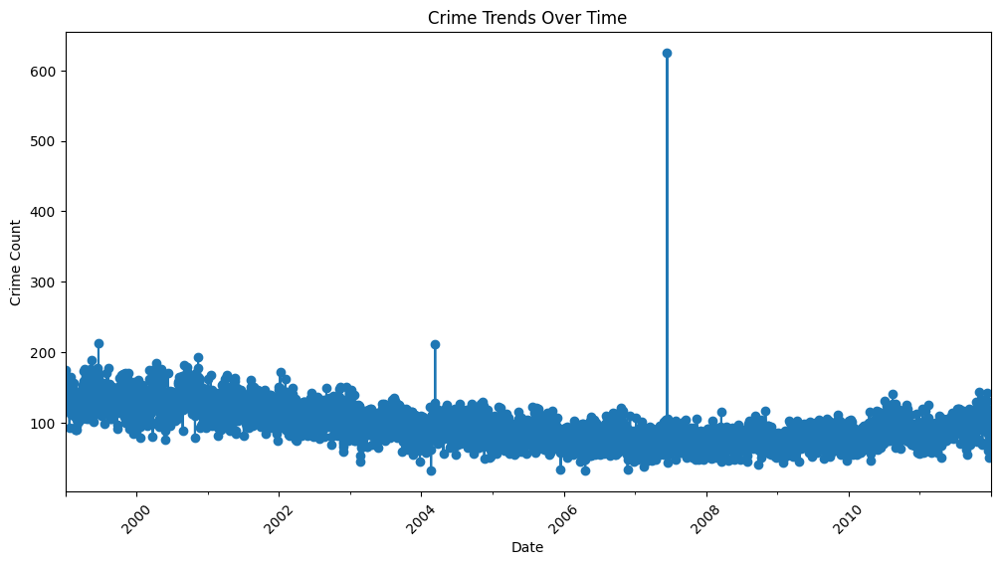

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Crime Trends Over Time
plt.figure(figsize=(12, 6))
df.groupby("Date").size().plot(kind="line", marker="o")
plt.title("Crime Trends Over Time")
plt.xlabel("Date")
plt.ylabel("Crime Count")
plt.xticks(rotation=45)
plt.show()

A bar chart (countplot) is ideal for visualizing crime distribution across different hours of the day.

Crime occurrences are lowest during early morning hours (3 AM - 6 AM).

There is a gradual increase in crime activity from the morning to the evening.

A sharp peak around 6 PM (18:00 hours) suggests that crime is most frequent at this time.

Another notable increase around midnight (12 AM - 1 AM) might indicate late-night crimes, such as assaults, thefts, or disturbances.

<ipython-input-31-7f34f533edf6>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="HOUR", data=df, palette="coolwarm")


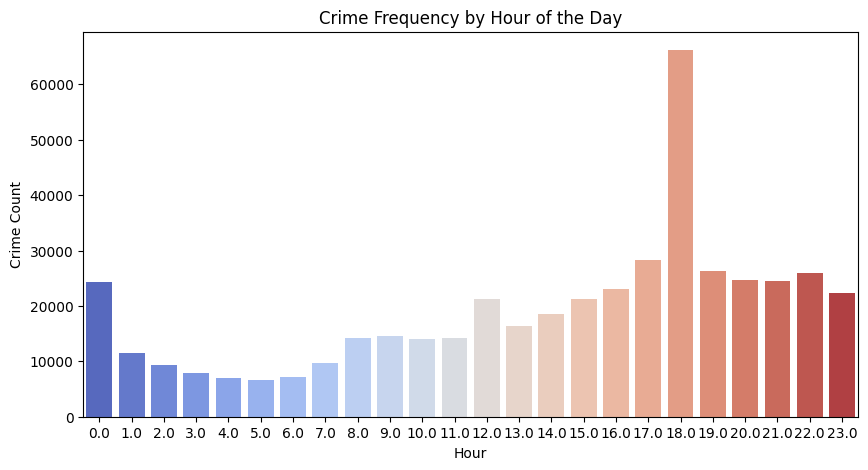

In [ ]:
# 2. Crime by Hour
plt.figure(figsize=(10, 5))
sns.countplot(x="HOUR", data=df, palette="coolwarm")
plt.title("Crime Frequency by Hour of the Day")
plt.xlabel("Hour")
plt.ylabel("Crime Count")
plt.show()


A horizontal bar chart (countplot) is ideal for comparing different crime types.

Theft from Vehicles is the most common crime, significantly higher than any other type.

Mischief and Break and Enter (Residential/Other) are also among the most frequent crimes.

Crimes like "Offence Against a Person" and "Vehicle Collision with Injury" are much less frequent.



<ipython-input-24-b3a0c36368a1>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y=df["TYPE"], order=df["TYPE"].value_counts().index, palette="viridis")


Text(0, 0.5, 'TYPE')

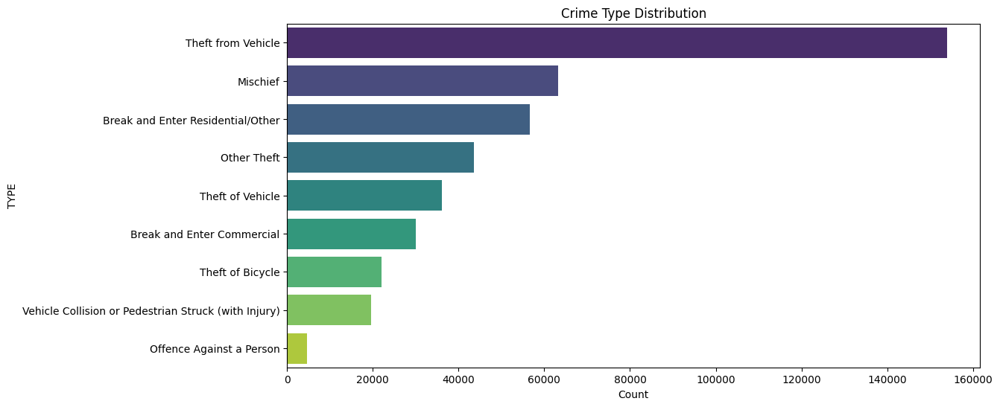

In [ ]:
# 3. Crime Type Distribution
plt.figure(figsize=(12, 6))
sns.countplot(y=df["TYPE"], order=df["TYPE"].value_counts().index, palette="viridis")
plt.title("Crime Type Distribution")
plt.xlabel("Count")
plt.ylabel("TYPE")

import pandas as pd
import matplotlib.pyplot as plt

# Group the data by Date and Crime Type and count occurrences
crime_counts = df.groupby(['Date', 'TYPE']).size().unstack(fill_value=0)

# Plot the occurrences over time for each crime type
crime_counts.plot(kind='line', figsize=(12, 6))

# Customize the plot for better readability
plt.title('Occurrences of Each Crime Type Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Occurrences')
plt.legend(title='Crime Type')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


A line chart is ideal for visualizing trends over time. Since the data represents crime occurrences over a 24-hour period, this chart helps observe patterns and fluctuations.
Theft from Vehicles peaks late at night and in the early morning hours (00:00 - 01:00) and then again in the evening (18:00 - 23:00).

Mischief and Other Theft increase steadily from late morning (10:00) and peak in the evening (17:00 - 22:00).

Break and Enter (both Residential & Commercial) have consistent activity but tend to rise in the afternoon.

Violent crimes (Offences Against a Person) peak around 18:00, possibly when people are returning home.

Vehicle collisions and pedestrian-related incidents remain relatively low but rise slightly in the afternoon and early evening.
High theft rates at night could discourage businesses from operating late hours.

Peak crime hours (18:00 - 23:00) might deter tourism and nightlife activities.

<Figure size 1200x600 with 0 Axes>

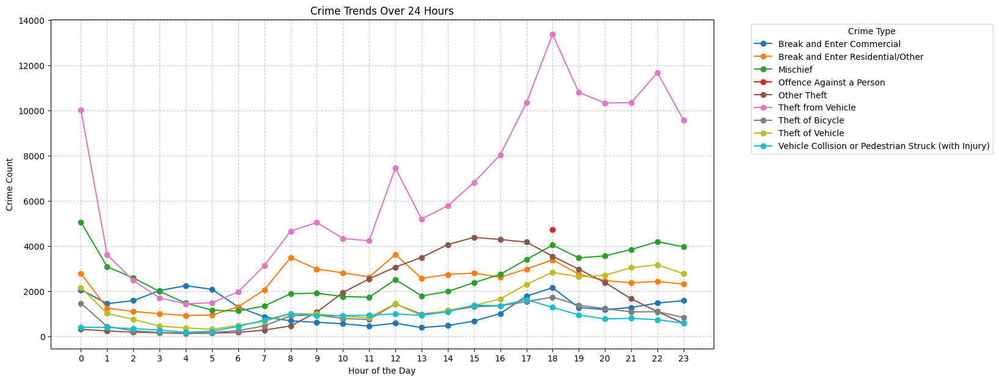

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

crime_hourly = df.groupby(["HOUR", "TYPE"]).size().unstack()

# Plot the line chart
plt.figure(figsize=(12, 6))
crime_hourly.plot(kind="line", marker="o", colormap="tab10", figsize=(14, 7))

# Labels and title
plt.title("Crime Trends Over 24 Hours")
plt.xlabel("Hour of the Day")
plt.ylabel("Crime Count")
plt.xticks(range(24))  # Ensure all 24 hours are shown
plt.legend(title="Crime Type", bbox_to_anchor=(1.05, 1), loc="upper left")

plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


Weekdays: Crime rates generally increase later in the day, with a significant peak in the evening hours (8 PM - 10 PM). The overall crime count on weekdays is higher compared to weekends.

Weekends: There's a noticeable spike in the late evening (8 PM - 11 PM), especially for certain types of crimes like "Break and Enter Commercial" and "Theft from Vehicle". However, the peak is less pronounced in comparison to weekdays.



<ipython-input-27-01d17235979f>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Date'] = pd.to_datetime(df['Date'])
<ipython-input-27-01d17235979f>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DAY_OF_WEEK'] = df['Date'].dt.dayofweek  # Monday=0, Sunday=6
<ipython-input-27-01d17235979f>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.

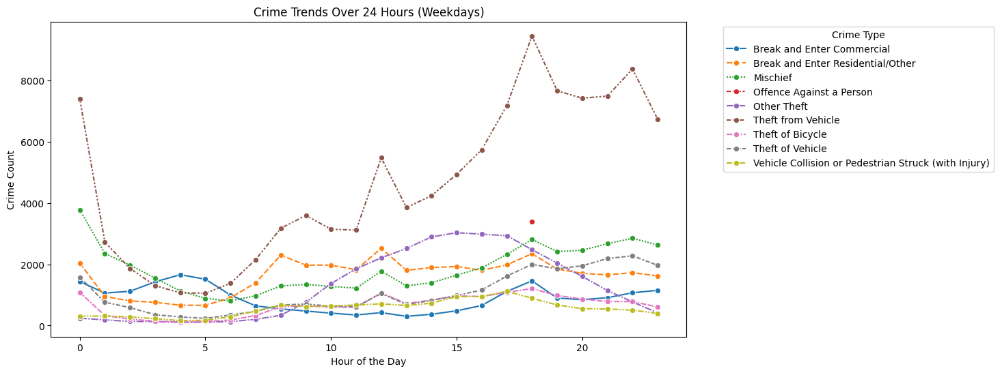

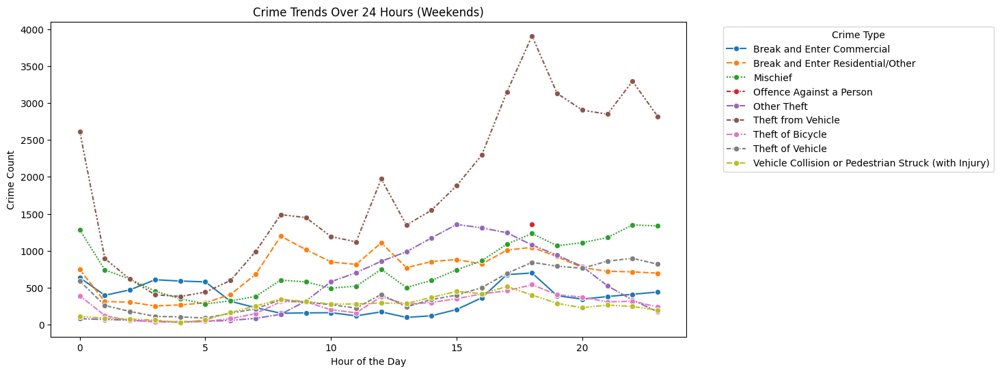

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df['Date'] = pd.to_datetime(df['Date'])
df['DAY_OF_WEEK'] = df['Date'].dt.dayofweek  # Monday=0, Sunday=6
df['IS_WEEKEND'] = df['DAY_OF_WEEK'] >= 5  # Saturday and Sunday are weekends

# Group by hour and crime type, separately for weekdays and weekends
weekday_counts = df[df['IS_WEEKEND'] == False].groupby(['HOUR', 'TYPE']).size().unstack()
weekend_counts = df[df['IS_WEEKEND'] == True].groupby(['HOUR', 'TYPE']).size().unstack()

# Plot weekday trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=weekday_counts, marker="o")
plt.title("Crime Trends Over 24 Hours (Weekdays)")
plt.xlabel("Hour of the Day")
plt.ylabel("Crime Count")
plt.legend(title="Crime Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

# Plot weekend trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=weekend_counts, marker="o")
plt.title("Crime Trends Over 24 Hours (Weekends)")
plt.xlabel("Hour of the Day")
plt.ylabel("Crime Count")
plt.legend(title="Crime Type", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


                                CONCLUSION
General Trend:

Crime rates are consistently high throughout the day on weekdays, with a peak in the evening hours (8 PM - 10 PM).

On weekends, crime is more concentrated in the late afternoon and night (especially 8 PM - 11 PM).

Crime Type Differences:

Weekdays: Higher incidents of "Break and Enter Commercial" and "Mischief," likely due to business hours and routine activities.

Weekends: More cases of "Offence Against a Person" and "Theft from Vehicle," suggesting that criminals take advantage of increased social activities and outdoor presence.

Security and Business Impact:

Businesses and law enforcement should focus on heightened security during evening hours on both weekdays and weekends.

Retail stores and commercial spaces should strengthen security protocols during weekday nights to prevent break-ins.

Public areas, entertainment venues, and parking zones should increase surveillance on weekends to counter theft and personal crimes.                                